# InceptionNet

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.datasets import Imagenette
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from torchvision.transforms import InterpolationMode as IM
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.gridspec as gs
import numpy as np
import random
import os
import re

In [2]:
os.makedirs("models", exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"
BATCH_SIZE = 256
NUM_EPOCHS = 30

In [3]:
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])

ds = Imagenette(root=".", split="train", download=False, transform=transform)
loader = DataLoader(ds, batch_size=64, shuffle=False, num_workers=4)

mean = 0.
std = 0.
n = 0
for imgs, _ in loader:
    B, C, H, W = imgs.shape
    imgs = imgs.view(B, C, -1)
    mean += imgs.mean(2).sum(0)
    std += imgs.std(2).sum(0)
    n += B

mean /= n
std /= n

In [4]:
def _rand_interp():
    return random.choice([IM.BILINEAR, IM.BICUBIC, IM.NEAREST, IM.BOX]) 


class RandomResizedCropWithRandInterp(transforms.RandomResizedCrop):
    def __init__(self, size):
        super().__init__(size=size, scale=(0.08, 1.0), ratio=(3/4, 4/3), interpolation=_rand_interp())

    def __call__(self, img):
        self.interpolation = _rand_interp()
        return super().__call__(img)

In [5]:
normalize = transforms.Normalize(mean, [1.0, 1.0, 1.0])


transform_train = transforms.Compose([
    RandomResizedCropWithRandInterp(224),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.ToTensor(),
    normalize,
])

transform_val = transforms.Compose([
    transforms.Resize(256, interpolation=IM.BILINEAR),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    normalize,
])


train_dataset = Imagenette(root=".", split='train', download=False, transform=transform_train)
test_dataset = Imagenette(root=".", split='val', download=False, transform=transform_val)


NUM_WORKERS = 8
PREFETCH    = 4

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    prefetch_factor=PREFETCH,
    pin_memory=(device == "cuda"),
    drop_last=True,
)

test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    prefetch_factor=PREFETCH,
    pin_memory=(device == "cuda"),
    drop_last=False,
)

In [6]:
class InceptionNet(nn.Module):

    def __init__(self, num_classes=10):
        super().__init__()
        
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu1 = nn.ReLU()
        self.maxpool1 = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.conv2 = nn.Conv2d(64, 64, kernel_size=1)
        self.bn2 = nn.BatchNorm2d(64)
        self.relu2 = nn.ReLU()
        
        self.conv3 = nn.Conv2d(64, 192, kernel_size=3, padding=1)
        self.bn3 = nn.BatchNorm2d(192)
        self.relu3 = nn.ReLU()
        self.maxpool2 = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.conv4 = nn.Conv2d(192, 64, kernel_size=1)  
        self.bn4 = nn.BatchNorm2d(64)
        self.relu4 = nn.ReLU()
        
        self.conv5 = nn.Conv2d(192, 96, kernel_size=1)  
        self.bn5 = nn.BatchNorm2d(96)
        self.relu5 = nn.ReLU()
        self.conv6 = nn.Conv2d(96, 128, kernel_size=3, padding=1)  
        self.bn6 = nn.BatchNorm2d(128)
        self.relu6 = nn.ReLU()
        
        self.conv7 = nn.Conv2d(192, 16, kernel_size=1)  
        self.bn7 = nn.BatchNorm2d(16)
        self.relu7 = nn.ReLU()
        self.conv8 = nn.Conv2d(16, 32, kernel_size=5, padding=2)  
        self.bn8 = nn.BatchNorm2d(32)
        self.relu8 = nn.ReLU()
        
        self.conv9 = nn.Conv2d(192, 32, kernel_size=1)  
        self.bn9 = nn.BatchNorm2d(32)
        self.relu9 = nn.ReLU()
        
        # Inception 3b
        self.conv10 = nn.Conv2d(256, 128, kernel_size=1)  
        self.bn10 = nn.BatchNorm2d(128)
        self.relu10 = nn.ReLU()
        
        self.conv11 = nn.Conv2d(256, 128, kernel_size=1)  
        self.bn11 = nn.BatchNorm2d(128)
        self.relu11 = nn.ReLU()
        self.conv12 = nn.Conv2d(128, 192, kernel_size=3, padding=1)  
        self.bn12 = nn.BatchNorm2d(192)
        self.relu12 = nn.ReLU()
        
        self.conv13 = nn.Conv2d(256, 32, kernel_size=1)  
        self.bn13 = nn.BatchNorm2d(32)
        self.relu13 = nn.ReLU()
        self.conv14 = nn.Conv2d(32, 96, kernel_size=5, padding=2)  
        self.bn14 = nn.BatchNorm2d(96)
        self.relu14 = nn.ReLU()
        
        self.conv15 = nn.Conv2d(256, 64, kernel_size=1)  
        self.bn15 = nn.BatchNorm2d(64)
        self.relu15 = nn.ReLU()
        
        self.maxpool3 = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        # Inception 4a
        self.conv16 = nn.Conv2d(480, 192, kernel_size=1)  
        self.bn16 = nn.BatchNorm2d(192)
        self.relu16 = nn.ReLU()
        
        self.conv17 = nn.Conv2d(480, 96, kernel_size=1)  
        self.bn17 = nn.BatchNorm2d(96)
        self.relu17 = nn.ReLU()
        self.conv18 = nn.Conv2d(96, 208, kernel_size=3, padding=1)  
        self.bn18 = nn.BatchNorm2d(208)
        self.relu18 = nn.ReLU()
        
        self.conv19 = nn.Conv2d(480, 16, kernel_size=1)  
        self.bn19 = nn.BatchNorm2d(16)
        self.relu19 = nn.ReLU()
        self.conv20 = nn.Conv2d(16, 48, kernel_size=5, padding=2)  
        self.bn20 = nn.BatchNorm2d(48)
        self.relu20 = nn.ReLU()
        
        self.conv21 = nn.Conv2d(480, 64, kernel_size=1)
        self.bn21 = nn.BatchNorm2d(64)
        self.relu21 = nn.ReLU()
        
        self.conv22 = nn.Conv2d(512, 160, kernel_size=1)  
        self.bn22 = nn.BatchNorm2d(160)
        self.relu22 = nn.ReLU()
        
        self.conv23 = nn.Conv2d(512, 112, kernel_size=1)  
        self.bn23 = nn.BatchNorm2d(112)
        self.relu23 = nn.ReLU()
        self.conv24 = nn.Conv2d(112, 224, kernel_size=3, padding=1)
        self.bn24 = nn.BatchNorm2d(224)
        self.relu24 = nn.ReLU()
        
        self.conv25 = nn.Conv2d(512, 24, kernel_size=1)  
        self.bn25 = nn.BatchNorm2d(24)
        self.relu25 = nn.ReLU()
        self.conv26 = nn.Conv2d(24, 64, kernel_size=5, padding=2)
        self.bn26 = nn.BatchNorm2d(64)
        self.relu26 = nn.ReLU()
        
        self.conv27 = nn.Conv2d(512, 64, kernel_size=1)
        self.bn27 = nn.BatchNorm2d(64)
        self.relu27 = nn.ReLU()
        
        self.conv28 = nn.Conv2d(512, 128, kernel_size=1)  
        self.bn28 = nn.BatchNorm2d(128)
        self.relu28 = nn.ReLU()
        
        self.conv29 = nn.Conv2d(512, 128, kernel_size=1)  
        self.bn29 = nn.BatchNorm2d(128)
        self.relu29 = nn.ReLU()
        self.conv30 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.bn30 = nn.BatchNorm2d(256)
        self.relu30 = nn.ReLU()
        
        self.conv31 = nn.Conv2d(512, 24, kernel_size=1)  
        self.bn31 = nn.BatchNorm2d(24)
        self.relu31 = nn.ReLU()
        self.conv32 = nn.Conv2d(24, 64, kernel_size=5, padding=2)
        self.bn32 = nn.BatchNorm2d(64)
        self.relu32 = nn.ReLU()
        
        self.conv33 = nn.Conv2d(512, 64, kernel_size=1)
        self.bn33 = nn.BatchNorm2d(64)
        self.relu33 = nn.ReLU()
        
        self.conv34 = nn.Conv2d(512, 112, kernel_size=1)  
        self.bn34 = nn.BatchNorm2d(112)
        self.relu34 = nn.ReLU()
        
        self.conv35 = nn.Conv2d(512, 144, kernel_size=1)  
        self.bn35 = nn.BatchNorm2d(144)
        self.relu35 = nn.ReLU()
        self.conv36 = nn.Conv2d(144, 288, kernel_size=3, padding=1)
        self.bn36 = nn.BatchNorm2d(288)
        self.relu36 = nn.ReLU()
        
        self.conv37 = nn.Conv2d(512, 32, kernel_size=1)  
        self.bn37 = nn.BatchNorm2d(32)
        self.relu37 = nn.ReLU()
        self.conv38 = nn.Conv2d(32, 64, kernel_size=5, padding=2)
        self.bn38 = nn.BatchNorm2d(64)
        self.relu38 = nn.ReLU()
        
        self.conv39 = nn.Conv2d(512, 64, kernel_size=1)
        self.bn39 = nn.BatchNorm2d(64)
        self.relu39 = nn.ReLU()
        
        self.conv40 = nn.Conv2d(528, 256, kernel_size=1)  
        self.bn40 = nn.BatchNorm2d(256)
        self.relu40 = nn.ReLU()
        
        self.conv41 = nn.Conv2d(528, 160, kernel_size=1)  
        self.bn41 = nn.BatchNorm2d(160)
        self.relu41 = nn.ReLU()
        self.conv42 = nn.Conv2d(160, 320, kernel_size=3, padding=1)
        self.bn42 = nn.BatchNorm2d(320)
        self.relu42 = nn.ReLU()
        
        self.conv43 = nn.Conv2d(528, 32, kernel_size=1)  
        self.bn43 = nn.BatchNorm2d(32)
        self.relu43 = nn.ReLU()
        self.conv44 = nn.Conv2d(32, 128, kernel_size=5, padding=2)
        self.bn44 = nn.BatchNorm2d(128)
        self.relu44 = nn.ReLU()
        
        self.conv45 = nn.Conv2d(528, 128, kernel_size=1)
        self.bn45 = nn.BatchNorm2d(128)
        self.relu45 = nn.ReLU()
        
        self.maxpool4 = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.conv46 = nn.Conv2d(832, 256, kernel_size=1)  
        self.bn46 = nn.BatchNorm2d(256)
        self.relu46 = nn.ReLU()
        
        self.conv47 = nn.Conv2d(832, 160, kernel_size=1)  
        self.bn47 = nn.BatchNorm2d(160)
        self.relu47 = nn.ReLU()
        self.conv48 = nn.Conv2d(160, 320, kernel_size=3, padding=1)
        self.bn48 = nn.BatchNorm2d(320)
        self.relu48 = nn.ReLU()
        
        self.conv49 = nn.Conv2d(832, 32, kernel_size=1)  
        self.bn49 = nn.BatchNorm2d(32)
        self.relu49 = nn.ReLU()
        self.conv50 = nn.Conv2d(32, 128, kernel_size=5, padding=2)
        self.bn50 = nn.BatchNorm2d(128)
        self.relu50 = nn.ReLU()
        
        self.conv51 = nn.Conv2d(832, 128, kernel_size=1)
        self.bn51 = nn.BatchNorm2d(128)
        self.relu51 = nn.ReLU()
        
        self.conv52 = nn.Conv2d(832, 384, kernel_size=1)
        self.bn52 = nn.BatchNorm2d(384)
        self.relu52 = nn.ReLU()
        
        self.conv53 = nn.Conv2d(832, 192, kernel_size=1)
        self.bn53 = nn.BatchNorm2d(192)
        self.relu53 = nn.ReLU()
        self.conv54 = nn.Conv2d(192, 384, kernel_size=3, padding=1)
        self.bn54 = nn.BatchNorm2d(384)
        self.relu54 = nn.ReLU()
        
        self.conv55 = nn.Conv2d(832, 48, kernel_size=1)  
        self.bn55 = nn.BatchNorm2d(48)
        self.relu55 = nn.ReLU()
        self.conv56 = nn.Conv2d(48, 128, kernel_size=5, padding=2)
        self.bn56 = nn.BatchNorm2d(128)
        self.relu56 = nn.ReLU()
        
        self.conv57 = nn.Conv2d(832, 128, kernel_size=1)
        self.bn57 = nn.BatchNorm2d(128)
        self.relu57 = nn.ReLU()
        
        # Final layers
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(1024, num_classes)
        

    def inception_module(self, x, conv1x1, bn1x1, relu1x1, 
                        conv3x3_reduce, bn3x3_reduce, relu3x3_reduce, conv3x3, bn3x3, relu3x3,
                        conv5x5_reduce, bn5x5_reduce, relu5x5_reduce, conv5x5, bn5x5, relu5x5,
                        pool_proj, bn_pool, relu_pool):

        branch1x1 = relu1x1(bn1x1(conv1x1(x)))
        
        branch3x3 = relu3x3_reduce(bn3x3_reduce(conv3x3_reduce(x)))
        branch3x3 = relu3x3(bn3x3(conv3x3(branch3x3)))
        
        branch5x5 = relu5x5_reduce(bn5x5_reduce(conv5x5_reduce(x)))
        branch5x5 = relu5x5(bn5x5(conv5x5(branch5x5)))
        
        branch_pool = F.max_pool2d(x, kernel_size=3, stride=1, padding=1)
        branch_pool = relu_pool(bn_pool(pool_proj(branch_pool)))
        
        outputs = [branch1x1, branch3x3, branch5x5, branch_pool]
        return torch.cat(outputs, 1)
    

    def forward(self, x):
        x = self.relu1(self.bn1(self.conv1(x)))
        x = self.maxpool1(x)
        x = self.relu2(self.bn2(self.conv2(x)))
        x = self.relu3(self.bn3(self.conv3(x)))
        x = self.maxpool2(x)
        
        x = self.inception_module(x, 
                                 self.conv4, self.bn4, self.relu4,
                                 self.conv5, self.bn5, self.relu5, self.conv6, self.bn6, self.relu6,
                                 self.conv7, self.bn7, self.relu7, self.conv8, self.bn8, self.relu8,
                                 self.conv9, self.bn9, self.relu9)
        
        x = self.inception_module(x,
                                 self.conv10, self.bn10, self.relu10,
                                 self.conv11, self.bn11, self.relu11, self.conv12, self.bn12, self.relu12,
                                 self.conv13, self.bn13, self.relu13, self.conv14, self.bn14, self.relu14,
                                 self.conv15, self.bn15, self.relu15)
        
        x = self.maxpool3(x)
        
        x = self.inception_module(x,
                                 self.conv16, self.bn16, self.relu16,
                                 self.conv17, self.bn17, self.relu17, self.conv18, self.bn18, self.relu18,
                                 self.conv19, self.bn19, self.relu19, self.conv20, self.bn20, self.relu20,
                                 self.conv21, self.bn21, self.relu21)
        
        x = self.inception_module(x,
                                 self.conv22, self.bn22, self.relu22,
                                 self.conv23, self.bn23, self.relu23, self.conv24, self.bn24, self.relu24,
                                 self.conv25, self.bn25, self.relu25, self.conv26, self.bn26, self.relu26,
                                 self.conv27, self.bn27, self.relu27)
        
        x = self.inception_module(x,
                                 self.conv28, self.bn28, self.relu28,
                                 self.conv29, self.bn29, self.relu29, self.conv30, self.bn30, self.relu30,
                                 self.conv31, self.bn31, self.relu31, self.conv32, self.bn32, self.relu32,
                                 self.conv33, self.bn33, self.relu33)
        
        x = self.inception_module(x,
                                 self.conv34, self.bn34, self.relu34,
                                 self.conv35, self.bn35, self.relu35, self.conv36, self.bn36, self.relu36,
                                 self.conv37, self.bn37, self.relu37, self.conv38, self.bn38, self.relu38,
                                 self.conv39, self.bn39, self.relu39)
        
        x = self.inception_module(x,
                                 self.conv40, self.bn40, self.relu40,
                                 self.conv41, self.bn41, self.relu41, self.conv42, self.bn42, self.relu42,
                                 self.conv43, self.bn43, self.relu43, self.conv44, self.bn44, self.relu44,
                                 self.conv45, self.bn45, self.relu45)
        
        x = self.maxpool4(x)
        
        x = self.inception_module(x,
                                 self.conv46, self.bn46, self.relu46,
                                 self.conv47, self.bn47, self.relu47, self.conv48, self.bn48, self.relu48,
                                 self.conv49, self.bn49, self.relu49, self.conv50, self.bn50, self.relu50,
                                 self.conv51, self.bn51, self.relu51)
        
        x = self.inception_module(x,
                                 self.conv52, self.bn52, self.relu52,
                                 self.conv53, self.bn53, self.relu53, self.conv54, self.bn54, self.relu54,
                                 self.conv55, self.bn55, self.relu55, self.conv56, self.bn56, self.relu56,
                                 self.conv57, self.bn57, self.relu57)
        
        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.dropout(x)
        x = self.fc(x)
        
        return x

In [7]:
def evaluate(model: nn.Module, loader: DataLoader, device: str, loss_fn: nn.Module) -> tuple[float, float, float]:
    model.eval()
    total_loss = 0.0
    total = 0
    top1_correct = 0
    top5_correct = 0

    with torch.no_grad():
        val_bar = tqdm(loader, desc="[Eval]", leave=False)
        for imgs, labels in val_bar:
            imgs = imgs.to(device, non_blocking=True)
            labels = labels.to(device, non_blocking=True)

            outputs = model(imgs)
            if isinstance(outputs, tuple):
                outputs = outputs[0]
            loss = loss_fn(outputs, labels)
            total_loss += loss.item()

            maxk = min(5, outputs.size(1))
            _, pred = outputs.topk(maxk, dim=1, largest=True, sorted=True)
            pred = pred.t()
            correct = pred.eq(labels.view(1, -1).expand_as(pred))

            top1_correct += correct[:1].sum().item()
            top5_correct += correct[:maxk].sum().item()
            total += labels.size(0)

    avg_loss = total_loss / len(loader)
    top1_acc = 100.0 * top1_correct / total
    top5_acc = 100.0 * top5_correct / total
    return avg_loss, top1_acc, top5_acc

In [ ]:
model = InceptionNet()
model.to(device)

optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.9, weight_decay=2e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=8, gamma=0.96)
loss_fn = nn.CrossEntropyLoss()

In [9]:
for epoch in range(NUM_EPOCHS):
    model.train()
    train_loss = 0.0

    train_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{NUM_EPOCHS} [Train]", leave=False)
    for imgs, labels in train_bar:
        imgs = imgs.to(device, non_blocking=True)
        labels = labels.to(device, non_blocking=True)

        optimizer.zero_grad(set_to_none=True)
        outputs = model(imgs)
        loss = loss_fn(outputs, labels)
            
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

    avg_train_loss = train_loss / len(train_loader)
    
    avg_val_loss, top1_acc, top5_acc = evaluate(model, test_loader, device, loss_fn)

    scheduler.step()

    print(f"Epoch {epoch+1} - Train loss: {avg_train_loss:.4f} | "
          f"Val loss: {avg_val_loss:.4f} | Top-1 val acc: {top1_acc:.2f}% | Top-5 val acc: {top5_acc:.2f}%" )

    if (epoch + 1) % 5 == 0:
        torch.save({
            "epoch": epoch,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "train_loss": avg_train_loss,
            "val_loss": avg_val_loss,
            "top1_val_acc": top1_acc, 
            "top5_val_acc": top5_acc,
        }, os.path.join("models", "inceptionnet_imagenette_checkpoint.pth"))


Epoch 1 - Train loss: 2.0773 | Val loss: 2.2653 | Top-1 val acc: 20.25% | Top-5 val acc: 65.25%


Epoch 2 - Train loss: 1.6519 | Val loss: 2.1679 | Top-1 val acc: 36.38% | Top-5 val acc: 78.04%


Epoch 3 - Train loss: 1.3855 | Val loss: 1.2860 | Top-1 val acc: 57.04% | Top-5 val acc: 93.78%


Epoch 4 - Train loss: 1.2341 | Val loss: 1.5417 | Top-1 val acc: 54.60% | Top-5 val acc: 92.74%


Epoch 5 - Train loss: 1.1345 | Val loss: 1.0655 | Top-1 val acc: 65.89% | Top-5 val acc: 94.06%


Epoch 6 - Train loss: 1.0569 | Val loss: 1.3310 | Top-1 val acc: 59.18% | Top-5 val acc: 93.30%


Epoch 7 - Train loss: 1.0106 | Val loss: 0.8678 | Top-1 val acc: 72.25% | Top-5 val acc: 96.43%


Epoch 8 - Train loss: 0.9309 | Val loss: 0.8840 | Top-1 val acc: 72.13% | Top-5 val acc: 97.38%


Epoch 9 - Train loss: 0.8921 | Val loss: 0.7006 | Top-1 val acc: 77.38% | Top-5 val acc: 97.66%


Epoch 10 - Train loss: 0.8443 | Val loss: 0.7734 | Top-1 val acc: 75.67% | Top-5 val acc: 96.71%


Epoch 11 - Train loss: 0.8053 | Val loss: 0.7503 | Top-1 val acc: 75.46% | Top-5 val acc: 96.97%


Epoch 12 - Train loss: 0.7921 | Val loss: 0.8976 | Top-1 val acc: 71.46% | Top-5 val acc: 97.38%


Epoch 13 - Train loss: 0.7720 | Val loss: 0.7851 | Top-1 val acc: 76.10% | Top-5 val acc: 97.63%


Epoch 14 - Train loss: 0.7523 | Val loss: 1.2490 | Top-1 val acc: 65.38% | Top-5 val acc: 94.19%


Epoch 15 - Train loss: 0.6888 | Val loss: 0.8431 | Top-1 val acc: 74.57% | Top-5 val acc: 97.63%


Epoch 16 - Train loss: 0.6943 | Val loss: 0.7589 | Top-1 val acc: 77.96% | Top-5 val acc: 97.83%


Epoch 17 - Train loss: 0.6514 | Val loss: 0.6297 | Top-1 val acc: 80.00% | Top-5 val acc: 98.11%


Epoch 18 - Train loss: 0.6528 | Val loss: 0.8772 | Top-1 val acc: 71.62% | Top-5 val acc: 95.95%


Epoch 19 - Train loss: 0.6258 | Val loss: 0.8871 | Top-1 val acc: 73.86% | Top-5 val acc: 97.20%


Epoch 20 - Train loss: 0.6275 | Val loss: 0.7030 | Top-1 val acc: 77.25% | Top-5 val acc: 98.14%


Epoch 21 - Train loss: 0.5860 | Val loss: 0.6248 | Top-1 val acc: 80.10% | Top-5 val acc: 98.09%


Epoch 22 - Train loss: 0.6117 | Val loss: 0.5369 | Top-1 val acc: 83.67% | Top-5 val acc: 97.89%


Epoch 23 - Train loss: 0.5815 | Val loss: 0.5336 | Top-1 val acc: 83.11% | Top-5 val acc: 98.37%


Epoch 24 - Train loss: 0.5577 | Val loss: 0.5829 | Top-1 val acc: 81.66% | Top-5 val acc: 98.45%


Epoch 25 - Train loss: 0.5508 | Val loss: 0.5368 | Top-1 val acc: 82.88% | Top-5 val acc: 98.22%


Epoch 26 - Train loss: 0.5276 | Val loss: 0.6310 | Top-1 val acc: 80.99% | Top-5 val acc: 97.55%


Epoch 27 - Train loss: 0.5066 | Val loss: 0.6270 | Top-1 val acc: 80.18% | Top-5 val acc: 97.81%


Epoch 28 - Train loss: 0.5249 | Val loss: 0.6390 | Top-1 val acc: 81.12% | Top-5 val acc: 98.01%


Epoch 29 - Train loss: 0.5055 | Val loss: 0.5480 | Top-1 val acc: 82.45% | Top-5 val acc: 98.24%


Epoch 30 - Train loss: 0.5031 | Val loss: 0.6114 | Top-1 val acc: 80.61% | Top-5 val acc: 98.09%


# Visualising InceptionNet

In [7]:
checkpoint = torch.load("models/inceptionnet_imagenette_checkpoint.pth", map_location="cpu")
model = InceptionNet().to(device)
model.load_state_dict(checkpoint["model_state_dict"], strict=False)
model.eval()

InceptionNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (conv2): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
  (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (conv3): Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn3): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu3): ReLU()
  (maxpool2): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (conv4): Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1))
  (bn4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu4): ReLU()
  (conv5): Conv2d(192, 96, kernel_size=(1, 1), stride=(1, 1))
  (bn5): BatchNorm2d(96, eps=1e-05, mome

In [8]:
class GuidedBackprop:
    
    def __init__(self, model: nn.Module):
        self.model = model
        self._handles = []
        def fwd_relu(m: nn.Module, inp: tuple[torch.Tensor, ...], out: torch.Tensor) -> None: 
            m._gbp_out = out

        def bwd_relu(m: nn.Module, gin: tuple[torch.Tensor, ...], gout: tuple[torch.Tensor, ...]) -> tuple[torch.Tensor,]:
            mask = (m._gbp_out > 0).type_as(gout[0])
            return (torch.clamp(gout[0], min=0.0) * mask, )

        for m in self.model.modules():
            if isinstance(m, nn.ReLU):
                self._handles.append(m.register_forward_hook(fwd_relu))
                self._handles.append(m.register_full_backward_hook(bwd_relu))

    def close(self) -> None:
        for h in self._handles: h.remove()
        self._handles.clear()


def compute_rf(model: nn.Module, in_hw: tuple[int, int] = (224,224),
               layers: tuple[str, ...] = None) -> dict[str, tuple[int, int, float]]:
    """
    Return per-layer (rf_size, jump, start) in input pixel coords.
    start is the center (in pixel coords) of the [0,0] activation.
    """
    r, j, s = 1.0, 1.0, 0.5
    table = {}
    for name in layers:
        m = getattr(model, name)
        if isinstance(m, nn.Conv2d):
            k = float(m.kernel_size[0]); p = float(m.padding[0]); st = float(m.stride[0])
            r = r + (k - 1.0) * j
            s = s + ((k - 1.0) / 2.0 - p) * j
            j = j * st
        elif isinstance(m, nn.MaxPool2d):
            k = float(m.kernel_size if isinstance(m.kernel_size, int) else m.kernel_size[0])
            p = float(m.padding if isinstance(m.padding, int) else m.padding[0])
            st = float(m.stride if isinstance(m.stride, int) else m.stride[0])
            r = r + (k - 1.0) * j
            s = s + ((k - 1.0) / 2.0 - p) * j
            j = j * st
        table[name] = (int(round(r)), int(round(j)), float(s))

    return table

In [9]:
def _as_3x1x1(v):
    if v is None: 
        return None

    v = torch.tensor(v) if not isinstance(v, torch.Tensor) else v
    return v.float().view(3,1,1)


class Visualiser:
    """
    Guided ReLU visualisation with top-k activations per feature map,
    receptive-field matched patches.
    """

    TAP = {
        # stem
        "conv1":"relu1", "conv2":"relu2", "conv3":"relu3",
        "maxpool1":"maxpool1", "maxpool2":"maxpool2",

        # Inception 3a (conv4..conv9)
        "conv4":"relu4", "conv5":"relu5", "conv6":"relu6",
        "conv7":"relu7", "conv8":"relu8", "conv9":"relu9",

        # Inception 3b (conv10..conv15)
        "conv10":"relu10", "conv11":"relu11", "conv12":"relu12",
        "conv13":"relu13", "conv14":"relu14", "conv15":"relu15",

        "maxpool3":"maxpool3",

        # Inception 4a (conv16..conv21)
        "conv16":"relu16", "conv17":"relu17", "conv18":"relu18",
        "conv19":"relu19", "conv20":"relu20", "conv21":"relu21",

        # Inception 4b (conv22..conv27)
        "conv22":"relu22", "conv23":"relu23", "conv24":"relu24",
        "conv25":"relu25", "conv26":"relu26", "conv27":"relu27",

        # Inception 4c (conv28..conv33)
        "conv28":"relu28", "conv29":"relu29", "conv30":"relu30",
        "conv31":"relu31", "conv32":"relu32", "conv33":"relu33",

        # Inception 4d (conv34..conv39)
        "conv34":"relu34", "conv35":"relu35", "conv36":"relu36",
        "conv37":"relu37", "conv38":"relu38", "conv39":"relu39",

        # Inception 4e (conv40..conv45)
        "conv40":"relu40", "conv41":"relu41", "conv42":"relu42",
        "conv43":"relu43", "conv44":"relu44", "conv45":"relu45",

        "maxpool4":"maxpool4",

        # Inception 5a (conv46..conv51)
        "conv46":"relu46", "conv47":"relu47", "conv48":"relu48",
        "conv49":"relu49", "conv50":"relu50", "conv51":"relu51",

        # Inception 5b (conv52..conv57)
        "conv52":"relu52", "conv53":"relu53", "conv54":"relu54",
        "conv55":"relu55", "conv56":"relu56", "conv57":"relu57",
    }

    _RF_ORDER = [
        "conv1", "maxpool1",
        "conv2", "conv3", "maxpool2",

        # 3a
        "conv4","conv5","conv6","conv7","conv8","conv9",

        # 3b
        "conv10","conv11","conv12","conv13","conv14","conv15",

        "maxpool3",

        # 4a
        "conv16","conv17","conv18","conv19","conv20","conv21",

        # 4b
        "conv22","conv23","conv24","conv25","conv26","conv27",

        # 4c
        "conv28","conv29","conv30","conv31","conv32","conv33",

        # 4d
        "conv34","conv35","conv36","conv37","conv38","conv39",

        # 4e
        "conv40","conv41","conv42","conv43","conv44","conv45",

        "maxpool4",

        # 5a
        "conv46","conv47","conv48","conv49","conv50","conv51",

        # 5b
        "conv52","conv53","conv54","conv55","conv56","conv57",
    ]

    def __init__(self, model: nn.Module, device: str = device, mean: float = None, std: float = None):
        self.m = model.eval().to(device)
        self.device = device
        self.mean = _as_3x1x1(mean)
        self.std = _as_3x1x1(std)
        self.handles = []
        self.acts = {}
        self._keep_graph = False

        for name in self._RF_ORDER:
            self._register_activation(name)

        self.rf_tbl = compute_rf(self.m, in_hw=(224, 224), layers=self._RF_ORDER)


    def _register_activation(self, name: str) -> None:
        tap_name = self.TAP[name]
        mod = getattr(self.m, tap_name)
        def hook(_, __, out):
            self.acts[name] = out if self._keep_graph else out.detach()
        self.handles.append(mod.register_forward_hook(hook))


    @torch.no_grad()
    def _rank_channels_by_activity(self, loader: DataLoader, layer: str) -> list[int]:
        totals = None
        for imgs, _ in loader:
            imgs = imgs.to(self.device, non_blocking=True)
            _ = self._forward(imgs)
            A = self.acts[layer]
            m = A.mean(dim=(0,2,3))
            totals = m if totals is None else totals + m
        return torch.argsort(totals, descending=True).tolist()


    def close(self) -> None:
        for h in self.handles: h.remove()
        self.handles.clear()


    @torch.no_grad()
    def _forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.m(x)


    def _forward_with_grad(self, x: torch.Tensor) -> torch.Tensor:
        self._keep_graph = True
        out = self.m(x)
        self._keep_graph = False
        return out


    def _guided_from_unit(self, layer: str, fmap: int, y: int, x: int, img1x: torch.Tensor) -> torch.Tensor:
        gbp = GuidedBackprop(self.m)
        _ = self._forward_with_grad(img1x)
        scalar = self.acts[layer][0, fmap, y, x]
        self.m.zero_grad(set_to_none=True)
        scalar.backward(retain_graph=False)
        grad = img1x.grad.detach()[0]
        gbp.close()
        g = grad - grad.min()
        g = (g / (g.max() + 1e-8)).clamp(0,1)
        return g


    @staticmethod
    def _rf_box(rf: int, jump: int, start: float, y: int, x: int) -> tuple[int, int, int, int]:
        cy = int(round(start + y * jump))
        cx = int(round(start + x * jump))
        half = rf // 2
        y0, y1 = cy - half, cy + half + 1
        x0, x1 = cx - half, cx + half + 1
        return y0, y1, x0, x1


    @staticmethod
    def _rf_fully_inside(H: int, W: int, rf: int, jump: int, start: float, y: int, x: int) -> bool:
        y0, y1, x0, x1 = Visualiser._rf_box(rf, jump, start, y, x)
        return (y0 >= 0) and (x0 >= 0) and (y1 <= H) and (x1 <= W)


    @torch.inference_mode()
    def topk_for_featuremap(self, loader: DataLoader, layer: str, fmap: int, k: int = 9,
                            inside_only: bool = False, oversample_factor: int = 5):
        top = []
        rf, jump, start = self.rf_tbl[layer]
        for imgs, labels in loader:
            imgs = imgs.to(self.device, non_blocking=True)
            _ = self._forward(imgs)
            A = self.acts[layer]
            Hf, Wf = A.shape[-2:]
            Himg, Wimg = imgs.shape[-2:]
            n_cand = min(Hf * Wf, max(k, 1) * max(oversample_factor, 1))
            vals, idxs = A[:, fmap].view(imgs.size(0), -1).topk(n_cand, dim=1)
            for b in range(imgs.size(0)):
                for j in range(vals.shape[1]):
                    score = float(vals[b, j])
                    if score <= 0: continue
                    flat = int(idxs[b, j])
                    y, x = divmod(flat, Wf)
                    if inside_only and not self._rf_fully_inside(Himg, Wimg, rf, jump, start, y, x):
                        continue
                    top.append((score, (imgs[b].detach().cpu(), int(labels[b]), len(top)), (y, x)))
                    
        top = sorted(top, key=lambda t: t[0], reverse=True)[:k]
        return top


    @staticmethod
    def _crop_patch(img3hw: torch.Tensor, center_yx: tuple[int,int], rf_size: int, jump: int, start: float) -> torch.Tensor:
        H, W = img3hw.shape[-2], img3hw.shape[-1]
        y, x = center_yx
        cy = int(round(start + y * jump))
        cx = int(round(start + x * jump))
        half = rf_size // 2
        y0_des, y1_des = cy - half, cy + half + 1
        x0_des, x1_des = cx - half, cx + half + 1
        y0, y1 = max(0, y0_des), min(H, y1_des)
        x0, x1 = max(0, x0_des), min(W, x1_des)
        patch = img3hw[:, y0:y1, x0:x1]
        pad_top    = max(0, -y0_des)
        pad_bottom = max(0,  y1_des - H)
        pad_left   = max(0, -x0_des)
        pad_right  = max(0,  x1_des - W)
        if pad_left or pad_right or pad_top or pad_bottom:
            patch = F.pad(patch, (pad_left, pad_right, pad_top, pad_bottom))
        if patch.shape[-2:] != (rf_size, rf_size):
            patch = F.pad(
                patch,
                (0, max(0, rf_size - patch.shape[-1]),
                 0, max(0, rf_size - patch.shape[-2]))
            )[:, :rf_size, :rf_size]
        return patch


    def _denorm(self, patch: torch.Tensor) -> torch.Tensor:
        """Invert transforms.Normalize for display only."""
        if (self.mean is not None) and (self.std is not None):
            return (patch * self.std + self.mean).clamp(0, 1)

        return patch.clamp(0,1)


    def figure2_panel(
        self, 
        loader: DataLoader, 
        layers: tuple[str, ...] = (
            "conv1","conv3",
            "conv6","conv8",
            "conv12","conv14",
            "conv18","conv20",
            "conv24","conv26",
            "conv30","conv32",
            "conv36","conv38",
            "conv42","conv44",
            "conv48","conv50",
            "conv54","conv56",
        ),
        k_per_map: int = 9, 
        n_maps: int = 4, 
        seed: int = 0
    ) -> dict[str, list[tuple[torch.Tensor, torch.Tensor]]]:

        if isinstance(layers, str):
            layers = (layers,)

        rng = np.random.default_rng(seed)
        self.m.eval()
        panels = {}

        for layer in layers:
            C = getattr(self.m, layer).out_channels if layer.startswith("conv") else self.acts[layer].shape[1]
            ranked = self._rank_channels_by_activity(loader, layer)
            chosen = np.array(ranked[:min(n_maps, C)])
            rows = []
            rf, jump, start = self.rf_tbl[layer]
            guided_rows = {}

            for fmap in chosen:
                items = self.topk_for_featuremap(loader, layer, fmap, k=k_per_map, inside_only=True, oversample_factor=5)
                guided_imgs, patch_imgs = [], []
                for score, (img, lbl, _), (y, x) in items:
                    x_full = img.to(self.device, non_blocking=True).clone().unsqueeze(0)
                    patch_raw = self._crop_patch(img.cpu(), (y, x), rf, jump, start)
                    img1x = x_full.clone().requires_grad_(True)
                    gmap = self._guided_from_unit(layer, fmap, y, x, img1x).cpu()
                    gpatch = self._crop_patch(gmap, (y, x), rf, jump, start).clamp(0,1)

                    patch_disp = self._denorm(patch_raw)

                    guided_imgs.append(gpatch)
                    patch_imgs.append(patch_disp)

                if guided_imgs and patch_imgs:
                    rows.append((torch.stack(guided_imgs), torch.stack(patch_imgs)))

            panels[layer] = rows

        return panels


    @staticmethod
    def show_panels(panels: dict[str, list[tuple[torch.Tensor, torch.Tensor]]], title: str = "") -> None:
        for layer, rows in panels.items():
            if not rows:
                continue
            k = rows[0][0].shape[0]
            m = re.search(r"(\d+)", layer)
            layer_label = f"Layer {m.group(1)} ({layer})" if m else layer

            R = len(rows)
            fig = plt.figure(figsize=(2.0 * k * 2, 2.0 * R))
            grid = gs.GridSpec(R, 2, figure=fig, wspace=0.05, hspace=0.05)

            for r, (recs, patches) in enumerate(rows):
                axL = fig.add_subplot(grid[r, 0])
                grid_r = make_grid(recs, nrow=min(k, 9), padding=2)
                axL.imshow(np.transpose(grid_r.numpy(), (1, 2, 0)))
                axL.axis("off")

                axR = fig.add_subplot(grid[r, 1])
                grid_p = make_grid(patches, nrow=min(k, 9), padding=2)
                axR.imshow(np.transpose(grid_p.numpy(), (1, 2, 0)))
                axR.axis("off")

            fig.suptitle(f"{layer_label}", x=0.51, y=0.95, fontsize=22)
            fig.text(0.31, 0.89, "Guided ReLU Recons", ha="center", va="bottom", fontsize=20)
            fig.text(0.71, 0.89, "Image patches", ha="center", va="bottom", fontsize=20)

            plt.show()

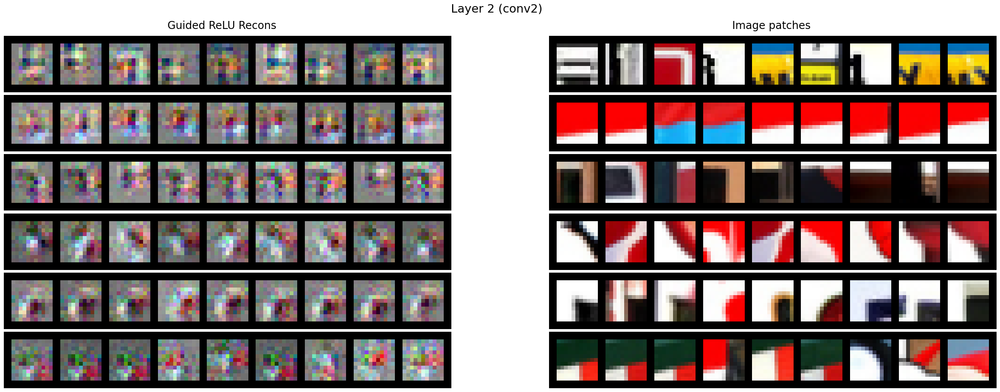

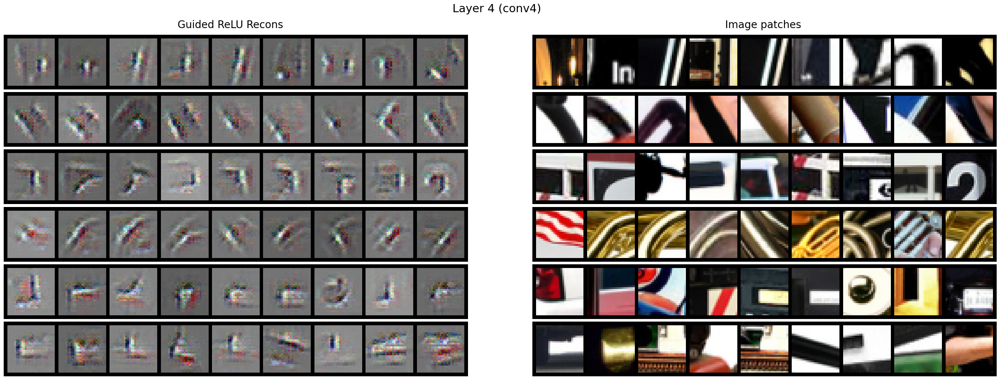

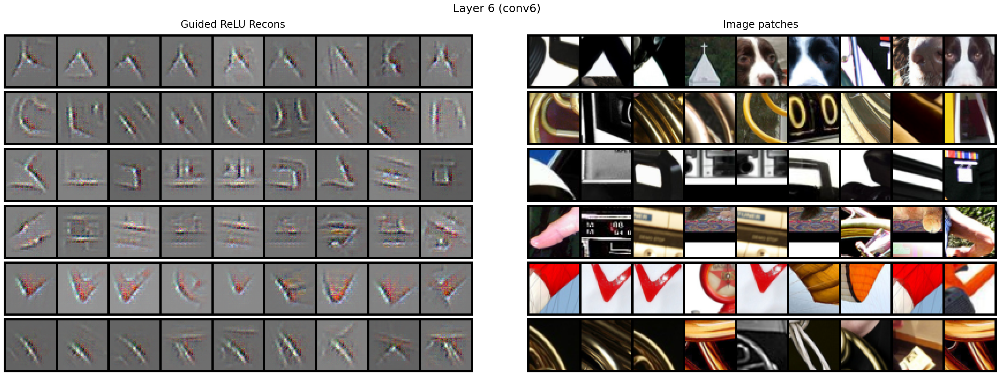

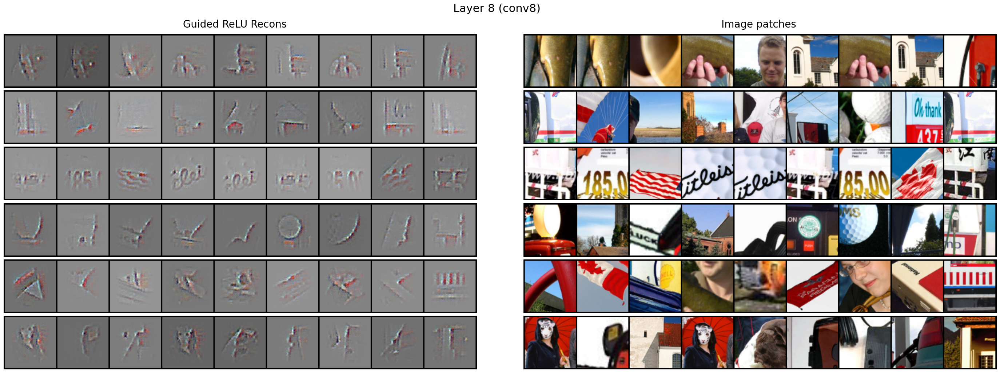

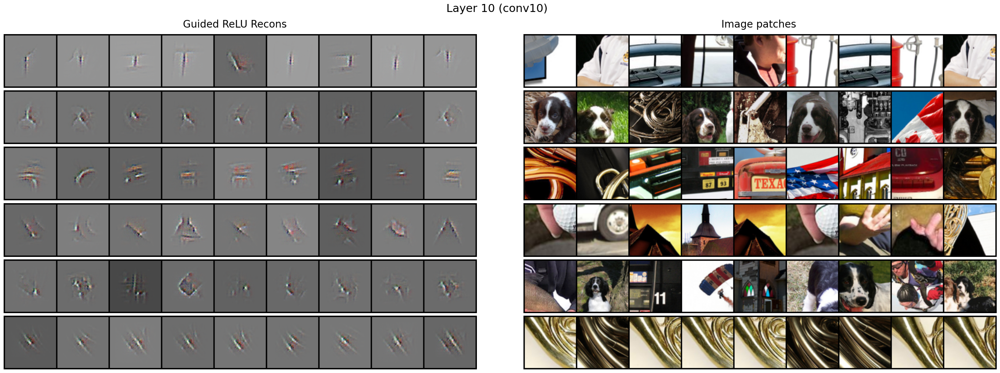

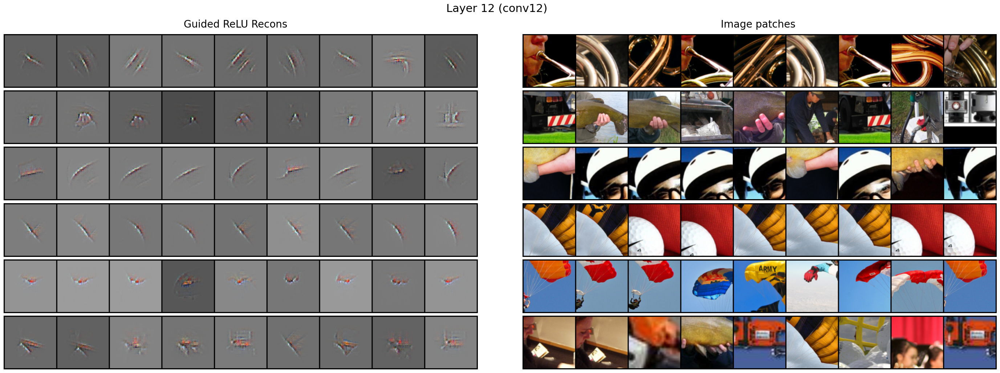

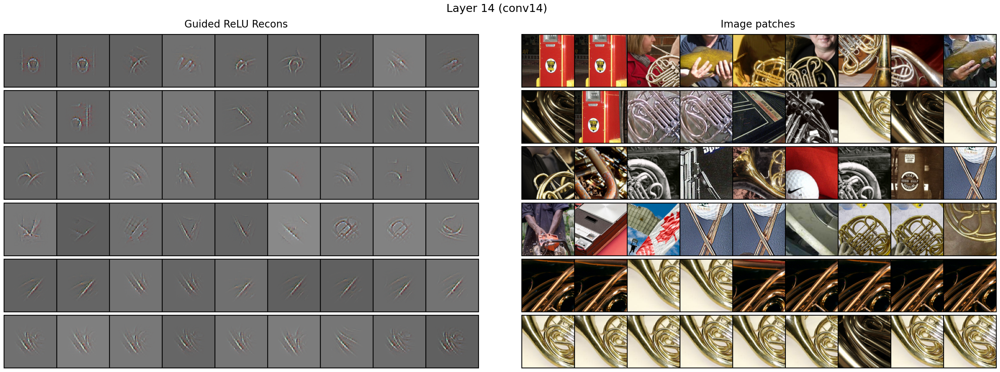

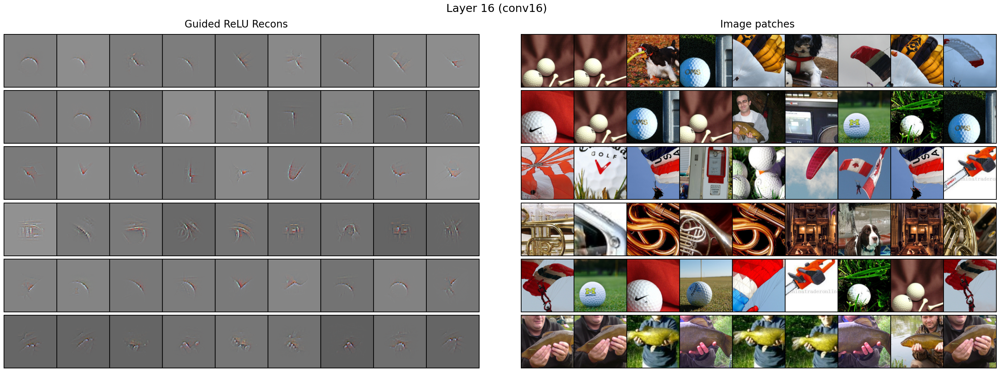

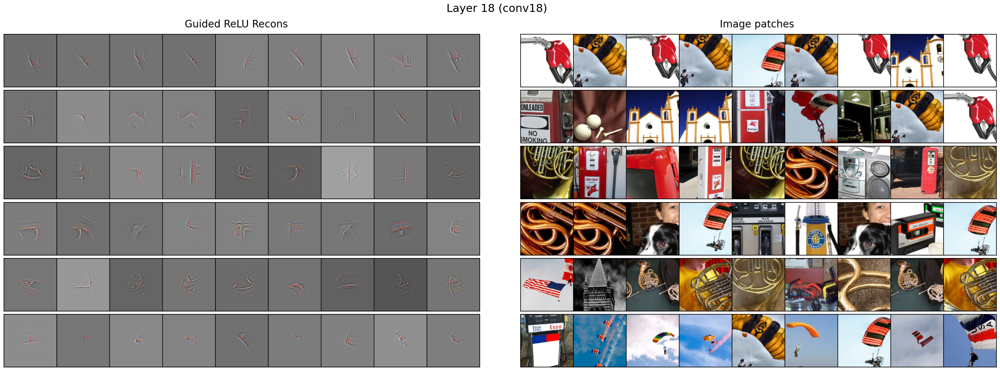

In [11]:
vis = Visualiser(model, device=device, mean=mean, std=[1.0, 1.0, 1.0])

panels = vis.figure2_panel(
    test_loader,
    layers=("conv2", "conv4", "conv6", "conv8", "conv10", "conv12", "conv14", "conv16", "conv18"),
    k_per_map=9,
    n_maps=6,
    seed=0,
)
vis.show_panels(panels)
vis.close()